In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import matplotlib as mpl
import itertools # to find combinations of features
%matplotlib inline
import networkx as nx # to plot network graphs 


# Intro 

- ### Using the MonsterScraper_ForEveryState.ipynb file, I web scraped data up to 250 job posts from every state for the search 'data scientist.

- ### The analysis will examine a few simple questions:
    - #### Which data science skills appear the most?
    - #### Which data science skills appear together?

# Import the data 

- ## First, we will import the data from the file scraped_data_4-6-2019.txt into a pandas dataframe.

In [2]:
data = []
data = pd.read_csv('scraped_data_4-6-2019.txt')

- ## I am skeptical about the 'c' column, so I will drop it 

In [3]:
data = data.drop(columns=['c'])

- ## Lets store the NY data for the analysis

In [4]:
data_NY = data[data['state'] == 'NY'].drop(columns=['state','job_title'])
data_US = data.drop(columns=['state','job_title'])

- ## Lets look at some of the sample sizes from each state

In [5]:
data.groupby('state').count()['python'].sort_values(ascending=False).head(50)

state
WA    363
NY    268
IL    250
CA    250
MI    250
MO    250
GA    250
FL    250
NC    250
CT    250
CO    250
NJ    250
MD    250
OH    250
OR    250
PA    250
AZ    250
TN    250
TX    250
UT    250
VA    250
MA    250
MN    226
WI    183
IN    179
AL    142
SC    135
DE    130
IA    126
KS    124
MS    100
NM     92
AR     87
NV     84
KY     83
HI     76
ID     75
WY     75
OK     74
NE     73
LA     64
ND     53
NH     50
SD     46
ME     39
RI     32
WV     31
VT     20
MT     18
AK     17
Name: python, dtype: int64

In [6]:
print('We apparently mined some extra data from WA and NY, but thats fine with me!')

We apparently mined some extra data from WA and NY, but thats fine with me!


# Question #1: What skills appear the most?
- ## Since I am a proud New Yorker, I will answer the question:'what skills are most important in New York?' 
- ## So, we need to find the frequency of occurance of each skill in the set of job posts in New York.

In [7]:
# Some Pandas Magic
prob_skill_and_NY = pd.DataFrame([data.groupby('state').mean().T.NY.sort_values(ascending=False)]).T

In [8]:
# Lets make a definition to normalize the data between zero and one
# This will be useful in multiple places
def normalizeZeroOne(array):
    return ((array)-min(array))/(max(array)-min(array))

## Lets plot the answer to our question!

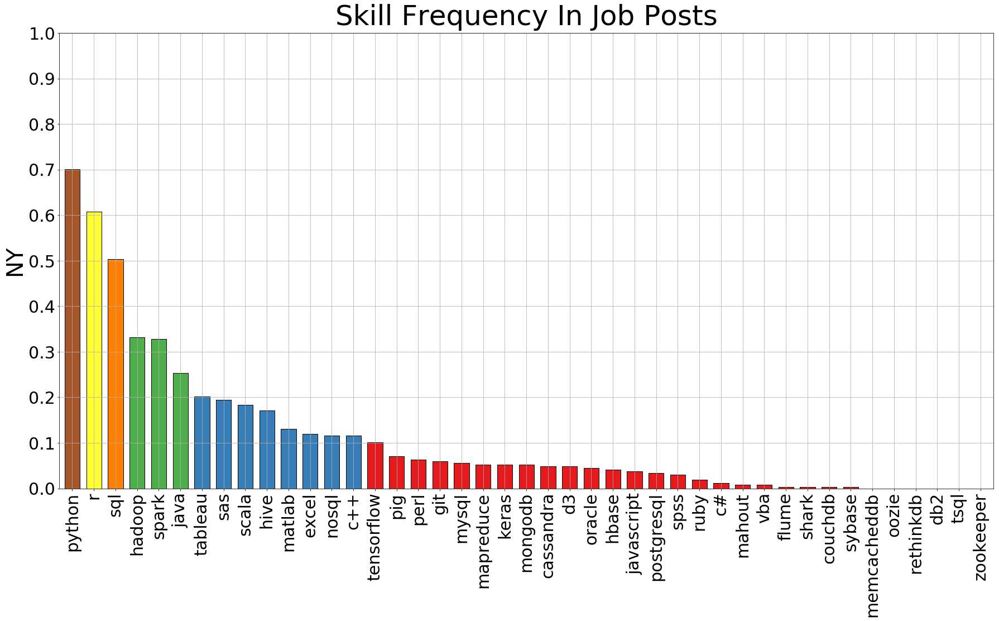

In [9]:
# Make the subplots
fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(30,15))

# Make the colorbar

## We will first create a norm, that will color the data within a interval that we define
## All possible values of the data span between 0 and 1, so we will use this for the input 
## of the norm in out colormap
norm = mpl.colors.Normalize(vmin = 0,
                            vmax = 1)

## Second, we select the colormap that we want
cmap = mpl.cm.Set1

## Now we get the RGBA values using our norm and colormap for the values 
## where the values will color according to where their values fall in the normalized scale
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
bar_colors = m.to_rgba(prob_skill_and_NY['NY'].values)


# Add the plots to the subplots
prob_skill_and_NY['NY'].plot(ax = ax,
                             kind='bar',                             
                             color = bar_colors,
                             fontsize=30,
                             edgecolor = 'k',
                             ylim = [0,1],
                             width = .7)                

# Set tick frequency to .1 between 0 and 1
plt.yticks(np.arange(0, 1.1, .1))

# Add Gridlines
ax.grid(b=None, which='major', axis='both')

# Add ylabel
ax.set_ylabel('NY',fontsize=40)

# Add title
ax.set_title('Skill Frequency In Job Posts',fontsize=50,y=1.01)

# Show the plots
plt.show()

# Save the figure
fig.savefig('figures/NY_hist.png',bbox_inches='tight',pad_inches=0.1)

# I used color labels that adjust according to the skills value, so we can visually identify a few groups in the data:
- ## We can see that Python, R and SQL are the first tier with the highest demand.
- ## Hadoop, Spark, and Java are second tier.
- ## Tableau, SAS, Scala, and Hive are third tier.
- ## Matlab, Excel, NoSQL, c++, and tensorflow are fourth tier
- ## Then the remaining skills should appear for less than 1 in 10 job posts. 

## Lets take a look at this same plot, but also for job posts from the entire united states

In [10]:
# Get the probability of occurance of a skill for all of the states
prob_skill_and_US = pd.DataFrame(data.mean().sort_values(ascending=False),columns=['US'])


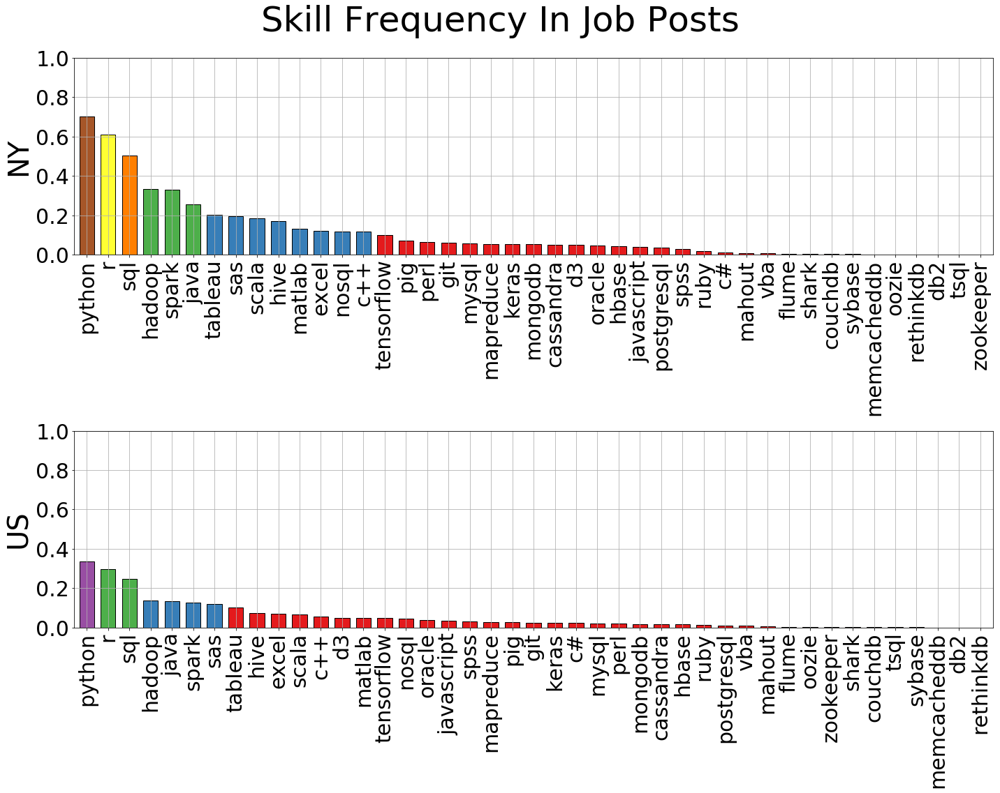

In [11]:
# Make the subplots
fig,ax = plt.subplots(nrows=2,ncols=1,figsize=(20,15))

# Make the colorbar

## We will first create a norm, that will color the data within a interval that we define
## All possible values of the data span between 0 and 1, so we will use this for the input 
## of the norm in out colormap
norm = mpl.colors.Normalize(vmin = 0,
                            vmax = 1)

## Second, we select the colormap that we want
cmap = mpl.cm.Set1

## Now we get the RGBA values using our norm and colormap for the values 
## where the values will color according to where their values fall in the normalized scale
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
NY_bar_colors = m.to_rgba(prob_skill_and_NY['NY'].values)
US_bar_colors = m.to_rgba(prob_skill_and_US['US'].values)

# Add the plots to the subplots
prob_skill_and_NY['NY'].plot(ax=ax[0],
                             kind='bar',
                             color = NY_bar_colors,
                             fontsize=30,
                             width = .7,
                             edgecolor='k',
                             ylim = [0,1])

prob_skill_and_US['US'].plot(ax=ax[1],
                             kind='bar',
                             color = US_bar_colors,
                             fontsize=30,
                             width = .7,
                             edgecolor='k',
                            ylim = [0,1])



# Add super title
fig.suptitle('Skill Frequency In Job Posts', fontsize=50, y=1.05)
# Add the ylabels to the plots
ax[0].set_ylabel('NY',fontsize=40)
ax[1].set_ylabel('US',fontsize=40)

# Add Gridlines
ax[0].grid(b=None, which='major', axis='both')
ax[1].grid(b=None, which='major', axis='both')

# Make the subplot layout tightly fit
fig.tight_layout()

# Show the plots
plt.show()

# Save the figure
fig.savefig('figures/NY_vs_US_hist.png',bbox_inches='tight',pad_inches=0.1)

# What can we say about these two plots?
- ## Although the scale is different, the shape seems to be is relatively the same
- ## Lets get rid of this difference in scale and just look at the shape of the plots. To do this we will normalize the data using the equation: 
## $$ x' = \frac{(x-min(x))} {(max(x)-min(x))} $$


In [12]:
    # Normalize with respect to python's probability for each set
prob_skill_and_NY_normalized = normalizeZeroOne(prob_skill_and_NY['NY'])
prob_skill_and_US_normalized = normalizeZeroOne(prob_skill_and_US['US'])

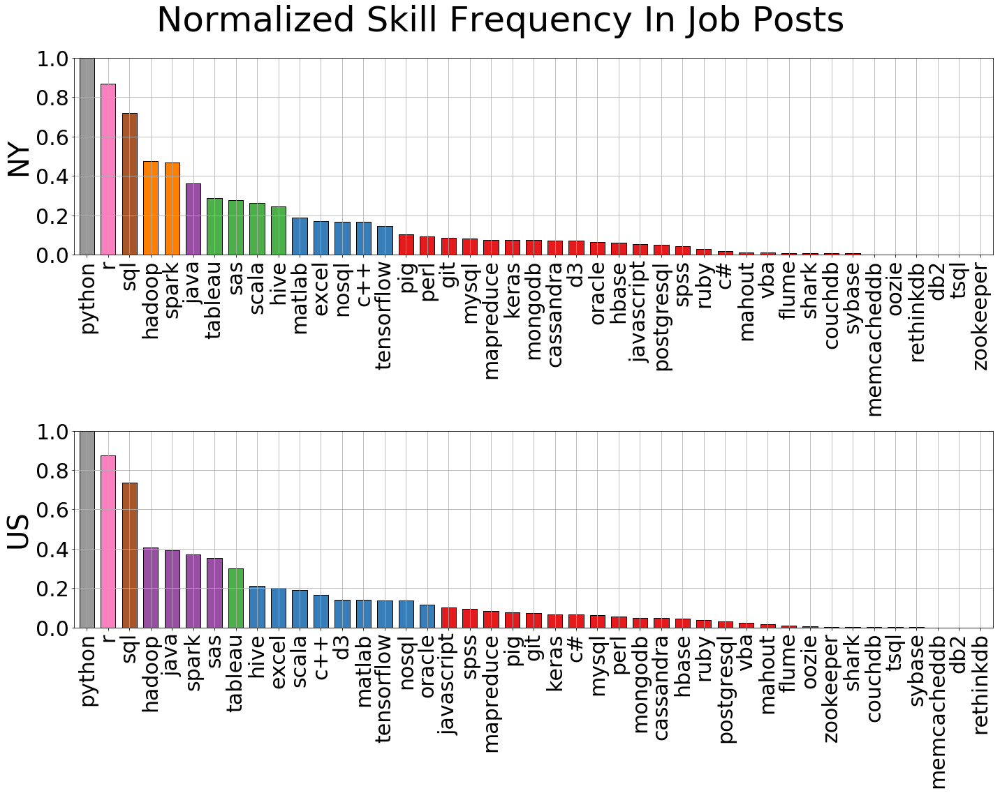

In [13]:
# Make the subplots
fig,ax = plt.subplots(nrows=2,ncols=1,figsize=(20,15))

# Add the plots to the subplots
prob_skill_and_NY_normalized.plot(ax =ax[0],kind='bar',fontsize=30,
                                  color = plt.cm.Set1(prob_skill_and_NY_normalized),
                                  edgecolor = 'k',
                                  width = .7,
                                  ylim=[0,1])
prob_skill_and_US_normalized.plot(ax=ax[1],kind='bar',fontsize=30,
                                  color=plt.cm.Set1(prob_skill_and_US_normalized),
                                  edgecolor = 'k',
                                  width = .7,
                                  ylim=[0,1])
# Add super title
fig.suptitle('Normalized Skill Frequency In Job Posts', fontsize=50, y=1.05)

# Add the labels to the plots y-axes
ax[0].set_ylabel('NY',fontsize=40)
ax[1].set_ylabel('US',fontsize=40)

# Add Gridlines
ax[0].grid(b=None, which='major', axis='both')
ax[1].grid(b=None, which='major', axis='both')

# Make the subplot layout tightly fit
fig.tight_layout()

# Show the plots
plt.show()

# Save the figure
fig.savefig('figures/NY_vs_US_normalized_hist.png',bbox_inches='tight',pad_inches=0.1)

# Now what is the same for these two normalized plots?
- ## As I previously speculated, the distribution profiles are very similar.
- ## Above all, Python, R and SQL are still dominating in demand in both the NY and the US dataset, and hadoop, java, and spark are are next in line.
- ## However, there are some subtle differences in these plots, and we can show this by taking the difference between them.


In [14]:
# Get the difference
diff_NY_and_US = (prob_skill_and_NY_normalized-prob_skill_and_US_normalized).sort_values(ascending=False)

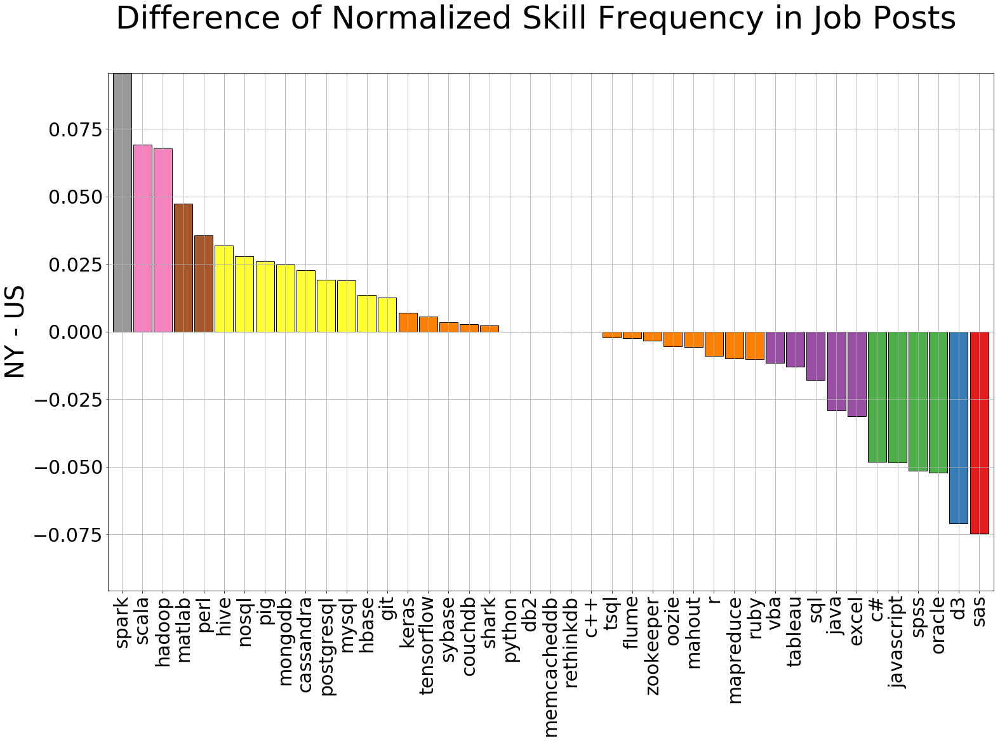

In [15]:
# Make the subplots
fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(25,15))


# Make the colorbar
## Since the color bar spans between positive and negative numbers,
## we will get the largest absolute value from the maximum and minimum 
# and use it to make a symmetrical colorbar

biggest_abs_value = max(
    np.abs(min(diff_NY_and_US.values)), # get the abs value of smallest value from the set 
    np.abs(max(diff_NY_and_US.values))) # get the abs values of largest value from the set

norm = mpl.colors.Normalize(vmin = -biggest_abs_value,
                            vmax = biggest_abs_value)

## We select the colormap that we want
cmap = mpl.cm.Set1

## Now we get the RGBA values using our norm and cmap for the node_weights and edge_weights
## where the values will color according to where their values fall in the normalized scale
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
bar_colors = m.to_rgba(diff_NY_and_US.values)



# Add the plots to the subplots
diff_NY_and_US.plot(ax =ax,kind='bar',
                    fontsize=30,
                    color=bar_colors,
                    edgecolor='k',
                    width = 0.9,
                   ylim = [-biggest_abs_value,biggest_abs_value])

# Add the labels to the plots y-axes
ax.set_ylabel('NY - US',fontsize=40)

# Add Gridlines
ax.grid(b=None, which='major', axis='both')

# Add super title
fig.suptitle('Difference of Normalized Skill Frequency in Job Posts', fontsize=50)

# Show the plots
plt.show()

# Save the figure
fig.savefig('figures/NY_vs_US_diff_hist.png',bbox_inches='tight',pad_inches=0.1)

# What differences do we see?
- ## New York has a greater preference for big data in comparison to the whole country, as the leading positive differences are Spark, Scala, and Hadoop (all relating to big data). There are also positive differences for modern database technologies (Hive, pig, mongodb, cassandra, and the list goes on). 
- ## On the other hand, New York cares less about data visualization technologies like tableau, excel, and d3, than does the rest of the country, and it is consistent to say that they are less interested in a traditional database like oracle. 

# Question #2: What skills appear together? 

- ## Lets look at the probability that a skill appears together with another skill ( In NY ;) ).

- ## Say we wanted to see what skills we should learn together, this might be the kind of data that we are looking for!

## Find the combinations of skills that appear together

- ###  we use the *itertools.combinaitons( )* library to find all the combintions of pairs where r = 2.

In [16]:
# Get a list of the individual skills
skills_NY = list(data_NY.columns) 

# Get the combination of pairs of skills
skill_pairs = [x for x in itertools.combinations(skills_NY, r = 2)]

# There will be a total of around 1000 new columns that we will generate
print(str(len(skill_pairs))+' combinations considered')

903 combinations considered


- ###  Now we will make a new column for each combination of skills.
- ### The value of a single row in the new column will be a 1 when the corresponding row from each column of the combination is 1.
- ### In otherwords... the value of a row is 1 when a combination of skills all appear together in a job post

In [17]:
# For every pair, take the product of the columns considered
# When row values are 1, the product will be 1 
# Otherwise when row values are not all 1, the product will be 0

# Initialize empty dataframe
pairs_NY = pd.DataFrame()

for each_pair in skill_pairs:

    #Store the product between pairs columns
    new_column = data_NY[list(each_pair)[0]]*data_NY[list(each_pair)[1]]
    
    # Add the new column to the dataframe
    pairs_NY[str(each_pair)] = new_column 
   

# Lets make the graph for the pairs of skills that occur together in  NY

/Users/mikegiacomazza/anaconda3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


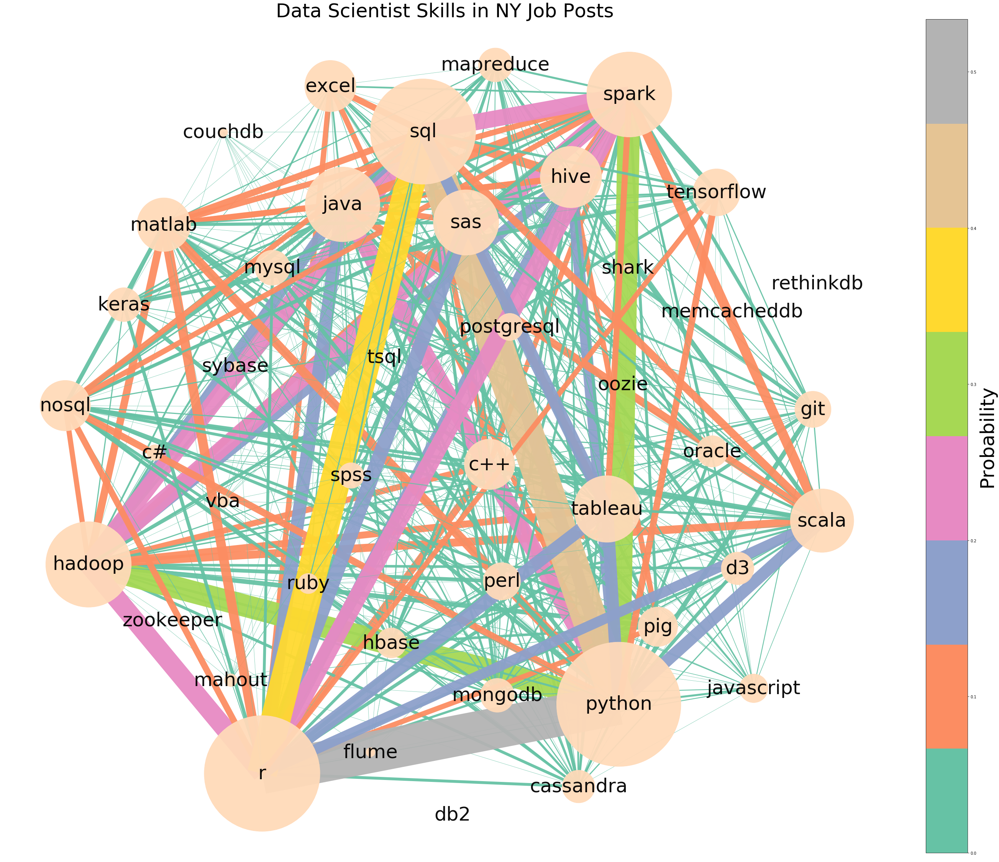

In [18]:
# Plot all NY cooccurances

# Get the nodes
nodes = skills_NY

# Get the node weights
node_weights = data_NY.mean()[skills_NY]

# Get the pairs
edges = [eval(x) for x in list(pairs_NY.keys())]

# Get the pair weights
edge_weights = pairs_NY.mean().values

# Initialize a Graph
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)
G.nodes
# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
plt.title('Data Scientist Skills in NY Job Posts',fontsize=50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)

# Coloring the graph
## We create a normal that will be used to color the edges that will need a max and min 
## value

## We will scale the normal according the the maximum of the NY pair data and set the minimum to zero

norm = mpl.colors.Normalize(vmin = 0,
                            vmax = max(edge_weights))

## We select the colormap that we want
cmap = mpl.cm.Set2

## Now we get the RGBA values using our norm and cmap for the edge_weights
## where the values will color according to where their values fall in the normalized scale
## that we created in the colormap object m
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
edge_colors = m.to_rgba(edge_weights)

nx.draw(G,
        graph_pos, 
        width = [200*x for x in edge_weights],
        edge_color = edge_colors,
        with_labels = True,
        
        # Include node weights for nodes in graph
        node_size = [150000*x for x in node_weights],
        node_color = 'peachpuff',
        
        # Make the edges and nodes transparent            
        alpha=.95,       
        font_size=50,
        font_color='k')

# Not sure what this does, but it is necessary to plot the colorbar
m._A = []

# Add the colorbar 
ax = plt.colorbar(m)

# Add label to colorbar
ax.set_label('Probability',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/NY_graph.png',bbox_inches='tight',pad_inches=0.1)

# How do we read this graph?
- ## The size of the nodes in the graph show how often skills appear on a job post
- ## The width of the connecting lines show how often the skills appear together in a job post
- ## The colors of the lines show lines with similar width

# What can we see?
- ## I see a lot of clutter and a lot of skills that don't appear together very often, so lets remove some less important skills

# Create a function that prunes the data

In [19]:
def pruneNodes(threshold,pairs_data_mean_values,skills):
    '''
    The input of pruneNodes is 'threshold', a value that is an upper probability limit,
    'pairs_data_mean_values' that is the dataframe of the mean for each of the paired skills,
    and 'skills' that is a list of stings for all of the individual skills.
    
    This function prunes all of skills and skill pairs that have all mean pairs_data values 
    below the threshold
    
    The return values are the pruned list of skill pairs and the pruned list of skills

    '''
    # Initialize an empty dictionary for the skills and lists of skill pairs
    skills_dictionary = {}

    # Get the groups of all possible pairs for each skill
    grouped_pairs = [[x for x in pairs_data_mean_values.keys() if y in eval(x)] for y in skills]
    count=0

    # Insert the list of skill pairs into a dictionary with the skills as keys
    for skill in skills:
        skills_dictionary[skill] = grouped_pairs[count]
        count+=1

    # If no edge weight inside of a node group is greater than the threshold value delete the 
    # column of that skill and all entries of that skill in other columns
    count = 0
    for skill in list(skills_dictionary.keys()):
        count += 1
        # if an entry in a group is higher than the threshold, 
        # then a false will appear in the group of skill pairs 
        # and that node is kept
        if False not in [x for x in pairs_data_mean_values[skills_dictionary[skill]]<threshold if x==False]:
            # Remove the node
            del skills_dictionary[skill]
            # Remove all of the entries of that node in the other dictionary entries by
            # remaking a list for every remaining list in the dictionary
            for x in list(skills_dictionary.keys()): 
                skills_dictionary[x] = [y for y in skills_dictionary[x] if skill not in eval(y)]

    # Get all of the pairs of skills with no redundancy
    pairs = []
    [pairs.append(x) for y in list(skills_dictionary.keys()) for x in skills_dictionary[y] if x not in pairs]
    
    # Get all remaining skills
    skills = list(skills_dictionary.keys())
    
    return pairs, skills

## We will remove any skill node that has all cooccurance frequencies that is below the value of the 95th percentile of the data

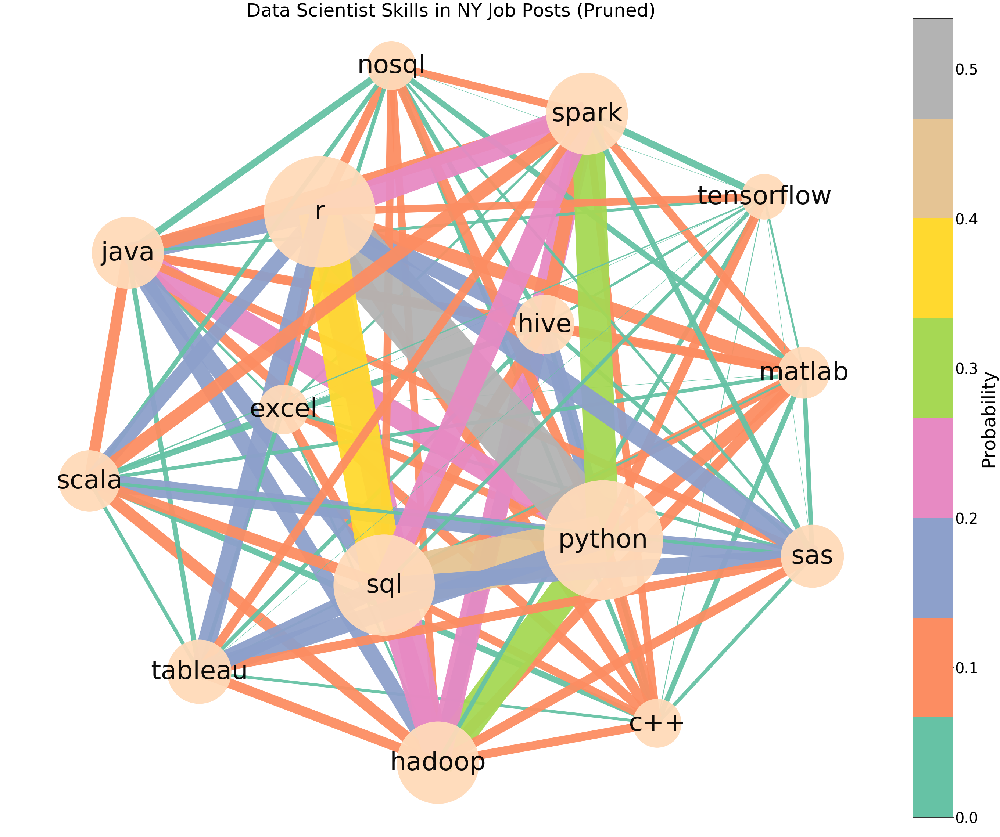

In [20]:
# Set the theshold quantile for the data 
threshold = pairs_NY.mean().quantile(.95)

# Remove the insignifigant factors i.e, those that 
# don't have a probability higher than a threshold 
# value for all of their edges
pruned_pairs, pruned_skills_NY = pruneNodes(threshold,
                                            pairs_NY.mean(),
                                            skills_NY)

# Get the nodes
nodes = pruned_skills_NY

# Get the node weights
node_weights = data_NY[pruned_skills_NY].mean().values

# Get the pairs
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
edge_weights = pairs_NY[pruned_pairs].mean().values

# Initialize a Graph
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
plt.title('Data Scientist Skills in NY Job Posts (Pruned)',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)

# Coloring the graph
## We create a normal that will be used to color the edges that will need a max and min 
## value

## We will scale the normal according the the maximum of the NY pair data and set the minimum to zero

norm = mpl.colors.Normalize(vmin = 0,
                            vmax = max(edge_weights))

## We select the colormap that we want
cmap = mpl.cm.Set2

## Now we get the RGBA values using our norm and cmap for the edge_weights
## where the values will color according to where their values fall in the normalized scale
## that we created in the colormap object m
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
edge_colors = m.to_rgba(edge_weights)

# Draw the graph
nx.draw(G,
        graph_pos, 
        width = [300*x for x in edge_weights],
        edge_color = edge_colors,
        with_labels = True,
        
        # Include node weights for nodes in graph
        node_size = [150000*x for x in node_weights],
        node_color = 'peachpuff',
        
        # Make the edges and nodes transparent            
        alpha=.95,       
        font_size=70,
        font_color='k')

# Not sure what this does, but it is necessary to plot the colorbar
m._A = []

# Add the colorbar 
ax = plt.colorbar(m)

# Add label to colorbar
ax.set_label('Probability',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/NY_graph_pruned.png',bbox_inches='tight',pad_inches=0.1)

# What can we see now?

# First, lets look at what skills occur together with Python:
- ## We see that Python and SQL occur together the most. 
- ## We see that Python and Spark, Python and Hadoop, and Python and Java, all occur the second most with the same frequency (This is an enlightening observation) :
    - ### Even though Hadoop is written in Java, Python and Hadoop appear together more frequently than Java and Hadoop. This indicates that there is most likely support for using Hadoop with Python and that it is in demand ( Hadoop Streaming, Hadoopy, Pydoop, and MRJob -  https://www.thomashenson.com/hadoop-python-example/) 
    - ### Furthermore, even though Spark is written in Scala, Python and Spark appear together more frequently than Spark and Scala. This also indicates that there is most likely support for using Spark with Python and it is in demand (PySpark - https://www.udemy.com/spark-and-python-for-big-data-with-pyspark/).

# Second, lets look at what skills occur together with R:
- ## We see that R and SQL occur together the most. 
- ## We see that R and Spark and R and Hadoop appear the seconds most with the same frequency (This is also an enlightening observation):
    - ### We can make the same argument. Even though Hadoop is written in Java, R and Hadoop appear together more frequently than Java and Hadoop. This indicates that there are most likely support for using Hadoop with R and it is in demand. (Hadoop Streaming, RHadoop, RHipe, ORCH, IBM BIGINSIGHTS BIG R).
    - ### Again, even though Spark is written in Scala, R and Spark appear together more frequently than Spark and Scala. This also indicates that there are most likely support for using Spark with R (sparklyr - https://www.datacamp.com/courses/introduction-to-spark-in-r-using-sparklyr).


# Now lets compare the cooccurance of skills in NY with the cooccurance of skills with the rest of the united states

- ## To do this, we will normalize the occurance and cooccurance data together in the NY dataset and the US dataset to be between 0 and 1 with the same equation used earlier.

## Find the combinations of skills that appear together

- ###  we use the *itertools.combinaitons( )* library to find all the combintions of pairs where r = 2.

In [21]:
# Get a list of the individual skills
skills_US = list(data_US.columns)

# Get the combination of pairs of skills
skill_pairs = [x for x in itertools.combinations(skills_US, r = 2)]

# There will be a total of around 1000 new columns that we will generate
print(str(len(skill_pairs))+' combinations considered')

903 combinations considered


- ###  Now we will make a new column for each combination of skills.
- ### The value of a single row in the new column will be a 1 when the corresponding row from each column of the combination is 1.
- ### In otherwords... the value of a row is 1 when a combination of skills all appear together in a job post

In [22]:
# For every pair, take the product of the columns considered
# When row values are 1, the product will be 1 
# Otherwise when row values are not all 1, the product will be 0

# Initialize empty dataframe
pairs_US = pd.DataFrame()

for each_pair in skill_pairs:

    #Store the product between pairs columns
    new_column = data_US[list(each_pair)[0]]*data_US[list(each_pair)[1]]
    
    # Add the new column to the dataframe
    pairs_US[str(each_pair)] = new_column 
   

# Lets get the graph for the pairs of skills that occur together for the Entire US.

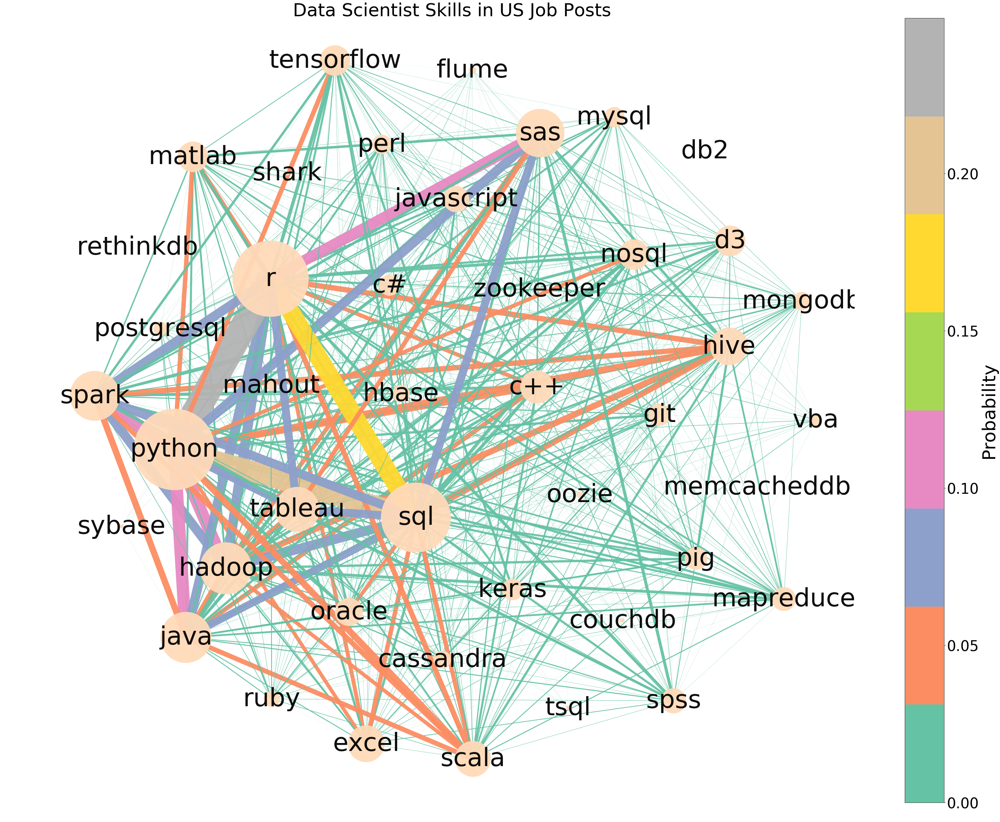

In [23]:
# Set the theshold quantile for the data 
threshold = pairs_US.mean().quantile(0)

# Remove the insignifigant factors i.e, those that 
# don't have a probability higher than a threshold 
# value for all of their edges
pruned_pairs, pruned_skills_US = pruneNodes(threshold,
                                            pairs_US.mean(),
                                            skills_US)
# Get the nodes
nodes = pruned_skills_US

# Get the node weights
node_weights = data_US[pruned_skills_US].mean().values

# Get the pairs
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
edge_weights = pairs_US[pruned_pairs].mean().values

# Initialize a Graph
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
plt.title('Data Scientist Skills in US Job Posts',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)
                    

# Coloring the graph
## We create a normal that will be used to color the edges that will need a max and min 
## value

## We will scale the normal according the the maximum of the NY pair data and set the minimum to zero

norm = mpl.colors.Normalize(vmin = 0,
                            vmax = max(edge_weights))

## We select the colormap that we want
cmap = mpl.cm.Set2

## Now we get the RGBA values using our norm and cmap for the edge_weights
## where the values will color according to where their values fall in the normalized scale
## that we created in the colormap object m
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
edge_colors = m.to_rgba(edge_weights)

# Draw the graph
nx.draw(G,
        graph_pos, 
        width = [300*x for x in edge_weights],
        edge_color = edge_colors,
        with_labels = True,
        
        # Include node weights for nodes in graph
        node_size = [150000*x for x in node_weights],
        node_color = 'peachpuff',
        
        # Make the edges and nodes transparent            
        alpha=.95,       
        font_size=70,
        font_color='k')

# Not sure what this does, but it is necessary to plot the colorbar
m._A = []

# Add the colorbar 
ax = plt.colorbar(m)

# Add label to colorbar
ax.set_label('Probability',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/US_graph.png',bbox_inches='tight',pad_inches=0.1)

# What can we see?
- ## Just as in the NY graph, I see a lot of clutter and a lot of skills that don't appear together very often, so lets remove some less important skills

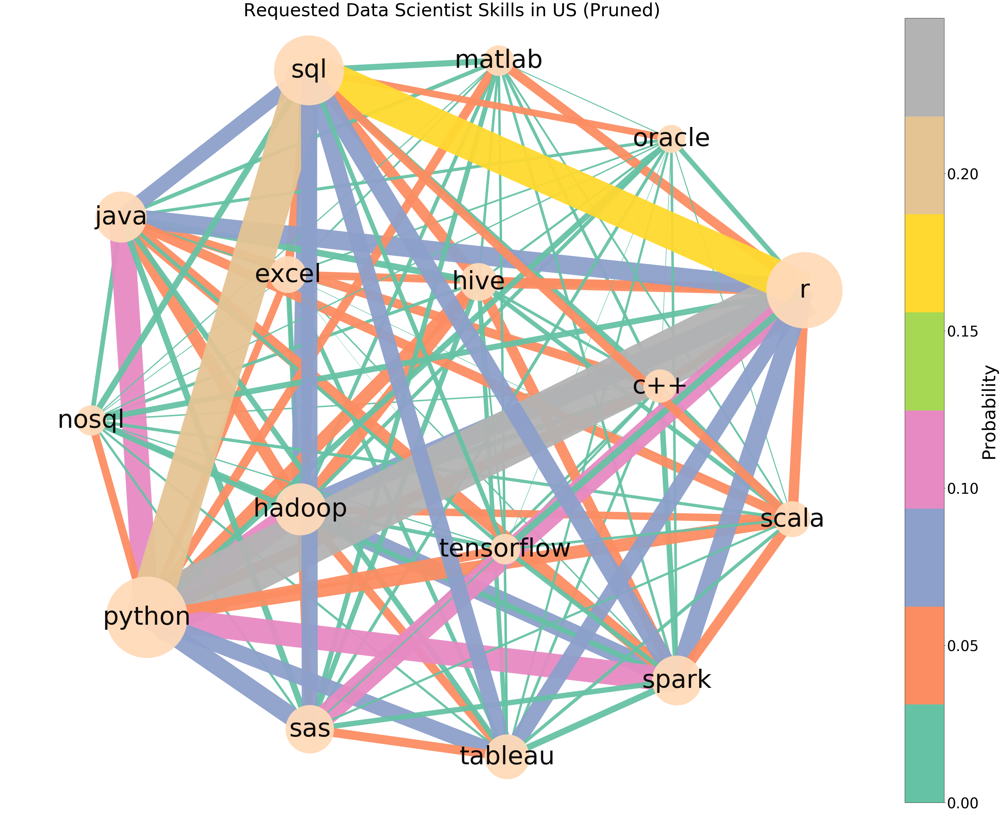

In [24]:
# Set the theshold quantile for the data 
threshold = pairs_US.mean().quantile(.95)

# Remove the insignifigant factors i.e, those that 
# don't have a probability higher than a threshold 
# value for all of their edges
pruned_pairs, pruned_skills_US = pruneNodes(threshold,
                                            pairs_US.mean(),
                                            skills_US)
# Get the nodes
nodes = pruned_skills_US

# Get the node weights
node_weights = data_US[pruned_skills_US].mean().values

# Get the pairs
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
edge_weights = pairs_US[pruned_pairs].mean().values

# Initialize a Graph
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
plt.title('Requested Data Scientist Skills in US (Pruned)',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)
                    

# Coloring the graph
## We create a normal that will be used to color the edges that will need a max and min 
## value

## We will scale the normal according the the maximum of the NY pair data and set the minimum to zero

norm = mpl.colors.Normalize(vmin = 0,
                            vmax = max(edge_weights))

## We select the colormap that we want
cmap = mpl.cm.Set2

## Now we get the RGBA values using our norm and cmap for the edge_weights
## where the values will color according to where their values fall in the normalized scale
## that we created in the colormap object m
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
edge_colors = m.to_rgba(edge_weights) # Use the same scale as NY

# Draw the graph
nx.draw(G,
        graph_pos, 
        width = [600*x for x in edge_weights],
        edge_color = edge_colors,
        with_labels = True,
        
        # Include node weights for nodes in graph
        node_size = [150000*x for x in node_weights],
        node_color = 'peachpuff',
        
        # Make the edges and nodes transparent            
        alpha=.95,       
        font_size=70,
        font_color='k')

# Not sure what this does, but it is necessary to plot the colorbar
m._A = []

# Add the colorbar 
ax = plt.colorbar(m)

# Add label to colorbar
ax.set_label('Probability',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/US_graph_pruned.png',bbox_inches='tight',pad_inches=0.1)

# What can we see now?

# First, lets look at what occurs together with Python:
- ## We see that Python and SQL occur together the most. 
- ## We see that Python and Spark, Python and Hadoop, and Python and Java, all occur with the same frequency (This is an enlightening observation) :
    - ### Even though Hadoop is written in Java, Python and Hadoop appear together more frequently than Java and Hadoop. This indicates that there are most likely supporting libraries for Hadoop in Python. 
    - ### Second, even though Spark is written in Scala, Python and Spark appear together more frequently than Spark and Scala. This also indicates that there are most likely supporting libraries for Spark in Python. 

# Second, lets look at what occurs with R:
- ## We see that R and SQL occur together the most. 
- ## We see that R and SAS occur together the second most.
- ## We see that R and Spark, R and Hadoop, R and Java, and R and Tableau, and a few other things appear together with the same frequency (This is also an enlightening observation):
    - ### Again, even though Hadoop is written in Java, R and Hadoop appear together more frequently than Java and Hadoop. This indicates that there are most likely supporting libraries for Hadoop in R. 
    - ### Again, even though Spark is written in Scala, R and Spark appear together more frequently than Spark and Scala. This also indicates that there are most likely supporting libraries for Spark in R. 


# VVVVVV FIX Colormap VVVVVV

# How do the pairs of skills that occur together for NY compare to the pairs of skills that occur together in the entire US?

## First get the Graph for the Normalized Cooccurance of skills in NY and Normalized occurance of skills in NY

In [25]:
# Get the normalized cooccurance data for skills in NY
cooc_data_NY_normalized = normalizeZeroOne(pairs_NY.mean())

# Get the normalized occurance data for skills in NY
data_NY_normalized = normalizeZeroOne(data_NY.mean())

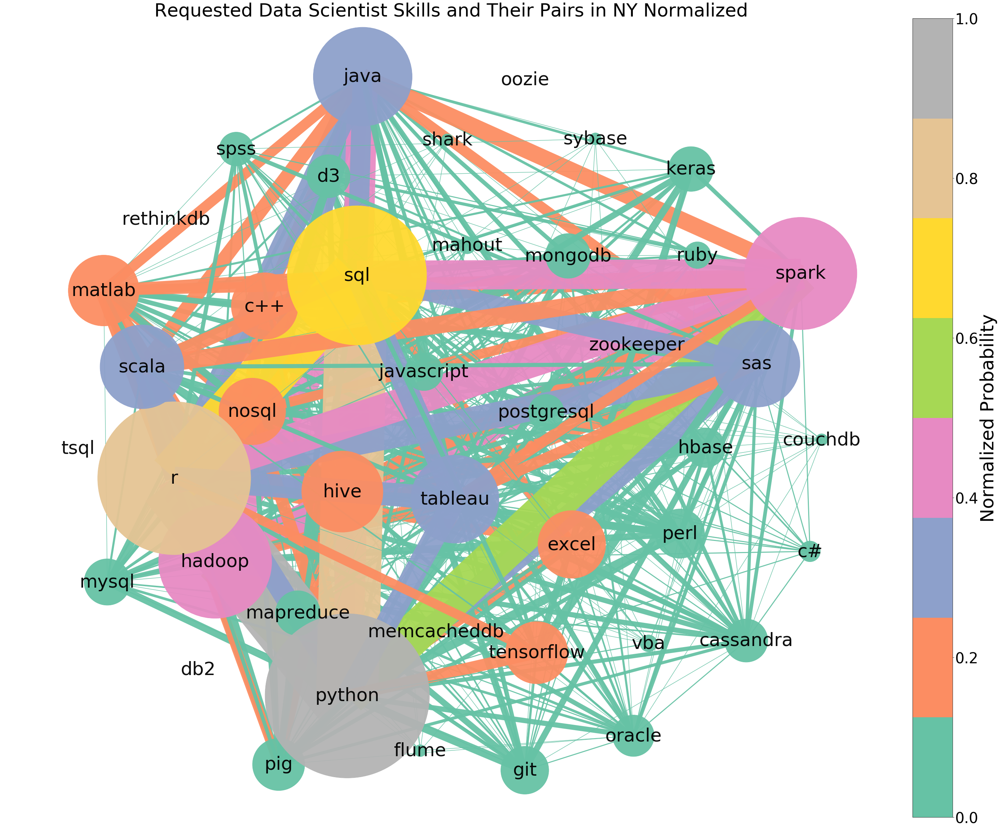

In [26]:
# Plot the normalized NY data

# Prune the data for all cooccurance values that are less than the threshold in pruneNodes
pruned_pairs, pruned_skills = pruneNodes(0, # The threshold
                                            cooc_data_NY_normalized, # The normalized pair data for NY
                                            skills_NY) # The skills list for NY

# Get Nodes
nodes = pruned_skills

# Get tuples of names for the pairs of skills
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
weights = cooc_data_NY_normalized.values

# Make the graph figure
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
plt.title('Requested Data Scientist Skills and Their Pairs in NY Normalized',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)
                
# Draw the graph
nx.draw(G,
        graph_pos,         
        width = [200*x for x in weights],
        edge_cmap = plt.cm.Set2,
        
        # edge_color values will assign the color interval from weights
        # that spans from min(weights) to max(weights)
        edge_color = plt.cm.Set2(weights),
        with_labels = True,
        node_size = [200000*x for x in data_NY_normalized[nodes]],
        
        # cmap for nodes
        cmap = plt.get_cmap('Set2'),
        node_color = plt.cm.Set2(data_NY_normalized[nodes].values),

        # Make the edges and nodes transparent            
        alpha=.95,
        font_size=50,
        font_color='k')

# Make a colorbar for the graph
sm = plt.cm.ScalarMappable(cmap=plt.cm.Set2,
                           # Set the values placed in the colorbar
                           norm=plt.Normalize(vmin=0,
                                              vmax=1))
                          
# Not sure what this does, but it is necessary to plot the colorbar
sm._A = []

# Add the colorbar 
ax = plt.colorbar(sm)

# Add label to colorbar
ax.set_label('Normalized Probability',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/NY_normalized_graph.png',bbox_inches='tight',pad_inches=0.1)

## Second get the Graph for the Normalized Cooccurance of skills in the US and Normalized occurance of skills in the US

In [27]:
# Get the normalized cooccurance data for skills in NY
cooc_data_US_normalized = normalizeZeroOne(pairs_US.mean())

# Get the normalized occurance data for skills in NY
data_US_normalized = normalizeZeroOne(data_US.mean())

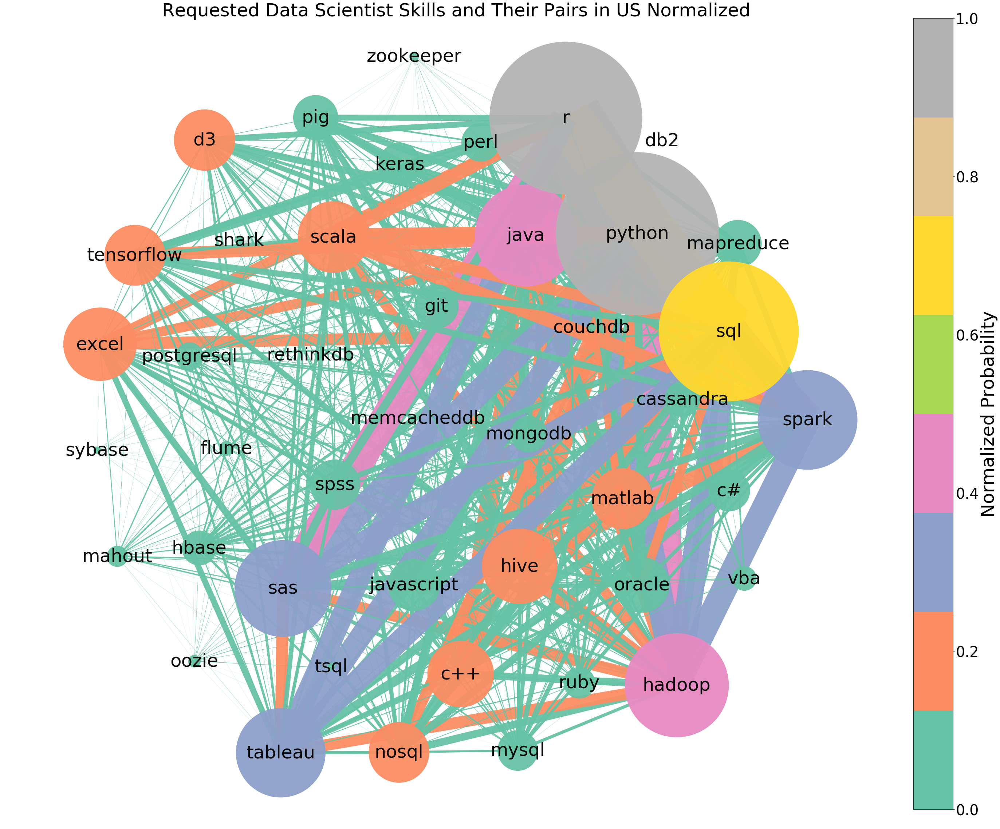

In [28]:
# Plot the normalized NY data

# Prune the data for all cooccurance values that are less than the threshold in pruneNodes
pruned_pairs, pruned_skills = pruneNodes(0, # The threshold
                                            cooc_data_US_normalized, # The normalized pair data for NY
                                            skills_US) # The skills list for NY
# Get Nodes
nodes = pruned_skills

# Get tuples of names for the pairs of skills
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
weights = cooc_data_US_normalized.values

# Make the graph figure
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
plt.title('Requested Data Scientist Skills and Their Pairs in US Normalized',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)
                
# Draw the graph
nx.draw(G,
        graph_pos, 
        width = [200*x for x in weights],
        edge_cmap = plt.cm.Set2,
        
        # edge_color values will assign the color interval from weights
        # that spans from min(weights) to max(weights)
        edge_color = plt.cm.Set2(weights),
        with_labels = True,
        node_size = [200000*x for x in data_US_normalized[nodes]],
        
        # cmap for nodes
        cmap = plt.get_cmap('Set2'),
        node_color = plt.cm.Set2(data_US_normalized[nodes].values),

        # Make the edges and nodes transparent            
        alpha=.95,
        font_size=50,
        font_color='k')

# Make a colorbar for the graph
sm = plt.cm.ScalarMappable(cmap=plt.cm.Set2,
                           # Set the values placed in the colorbar
                           norm=plt.Normalize(vmin=0,
                                              vmax=1))

# Not sure what this does, but it is necessary to plot the colorbar
sm._A = []

# Add the colorbar 
ax = plt.colorbar(sm)

# Add label to colorbar
ax.set_label('Normalized Probability',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/US_normalized_graph.png',bbox_inches='tight',pad_inches=0.1)

# ^^^^^^  FIX Colormap ^^^^^

# Third get the graph for the Normalized Cooccurance of Skills in NY minus the Normalized Cooccurance of Skills in the US and the Normalized Occurance of Skills in NY minus the Normalized Occurance of Skills in the US.

In [29]:
# Get the difference in the normalized Cooccurance data between NY and the US
cooc_data_NY_US_normalized_diff = cooc_data_NY_normalized - cooc_data_US_normalized

# Get the difference in the normalized Occurance data between NY and the US
data_NY_US_normalized_diff = data_NY_normalized - data_US_normalized

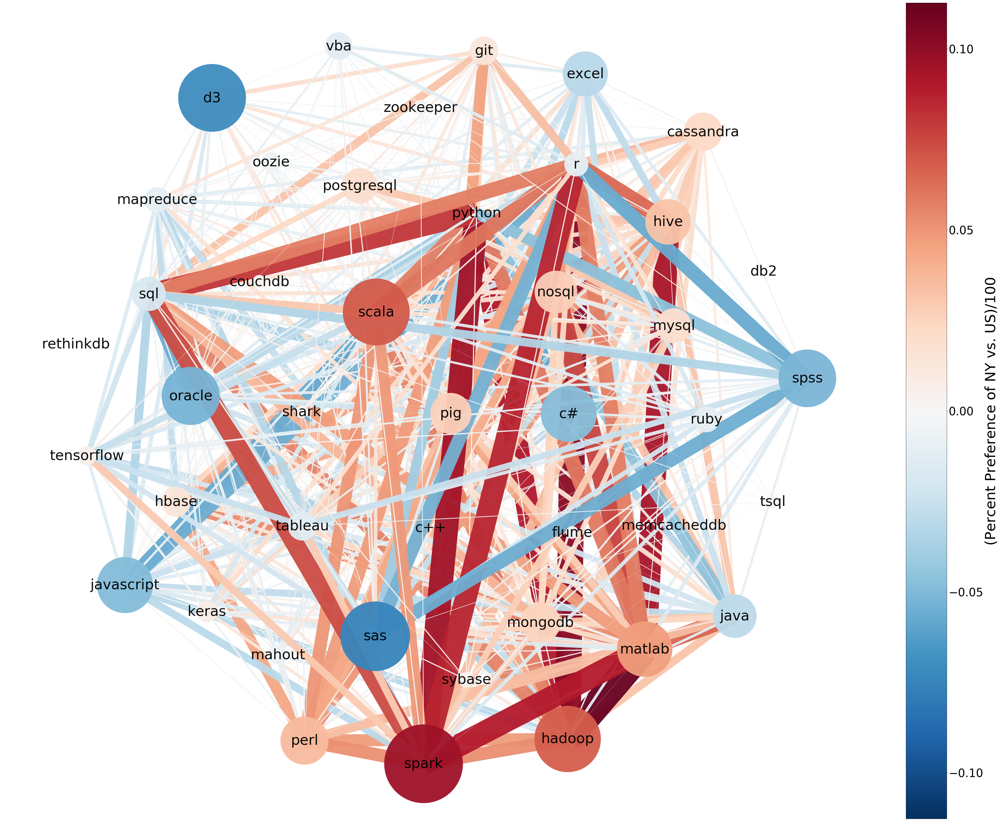

In [30]:
# Plot the normalized NY minus US data

# Make the threshold the xth percentile of all the values 
# when they are made to be positive
threshold = cooc_data_NY_US_normalized_diff.abs().quantile(0)

# Get the pruned data
pruned_pairs, pruned_skills_NY_US = pruneNodes(threshold, # The threshold
                                            cooc_data_NY_US_normalized_diff.abs(), # The absolute value of normalized pair data for NY minus US
                                            list(data_NY_US_normalized_diff.keys())) # The skills list for NY and US
# Get Nodes
nodes = pruned_skills_NY_US

# Get Node weights

node_weights = data_NY_US_normalized_diff[pruned_skills_NY_US].values

# Get the pairs
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
edge_weights = cooc_data_NY_US_normalized_diff[pruned_pairs].values

# Make the graph figure
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
# plt.title('Difference in Normalized Skill Frequency and Cooccurance of skills for US and NY',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)                 

# Coloring the graph

## We create a normal that will be used to color the nodes that will need a max and min 
## value

## Since the nodes and edges will be colored according to the same color bar, we will
## take the max and min from both sets combined and
## we will get the largest absolute value and use the positive and negative of that
## to make the colorbar symetrical

biggest_abs_value = max(
    np.abs(min(min(edge_weights),min(node_weights))), # get the smallest value from both sets
    np.abs(max(max(edge_weights),max(node_weights)))) # get the largest value from both sets

norm = mpl.colors.Normalize(vmin = -biggest_abs_value,
                            vmax = biggest_abs_value)

## We select the colormap that we want
cmap = mpl.cm.RdBu_r

## Now we get the RGBA values using our norm and cmap for the node_weights and edge_weights
## where the values will color according to where their values fall in the normalized scale
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
node_colors = m.to_rgba(node_weights)
edge_colors = m.to_rgba(edge_weights)

nx.draw(G,
        graph_pos, 
        
        # The values of the weights are both negative and positive, so the width will 
        # adjust according to the normalized absolute value of the width values
        width = [100*x for x in normalizeZeroOne(np.abs(edge_weights))],
 
        edge_color = edge_colors,
        
        # Add labels to the nodes
        with_labels = True,
        
        # Take the absolute value of the differences
        node_size = [abs(800000*x) for x in node_weights],
        
        # Use red to indicate positive and blue to indicate negative
        node_color = node_colors,
        
        # Make the edges and nodes transparent
        alpha=.95,
        font_size=50,
        font_color='k')

# Not sure what this does, but it is necessary to plot the colorbar
m._A = []

# Add the colorbar 
ax = plt.colorbar(m)

# Add label to colorbar
ax.set_label('(Percent Preference of NY vs. US)/100',fontsize=50)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 40.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/US_NY_normalized_diff_graph.png',bbox_inches='tight',pad_inches=0.1)

# What differences do we see? 

## Again, this looks like a tangled mess. So lets prune most of the less interesting stuff, like the skills with cooccurance values strictly between -.045 and .045.

## Fourth prune some of the smaller differences from the data.

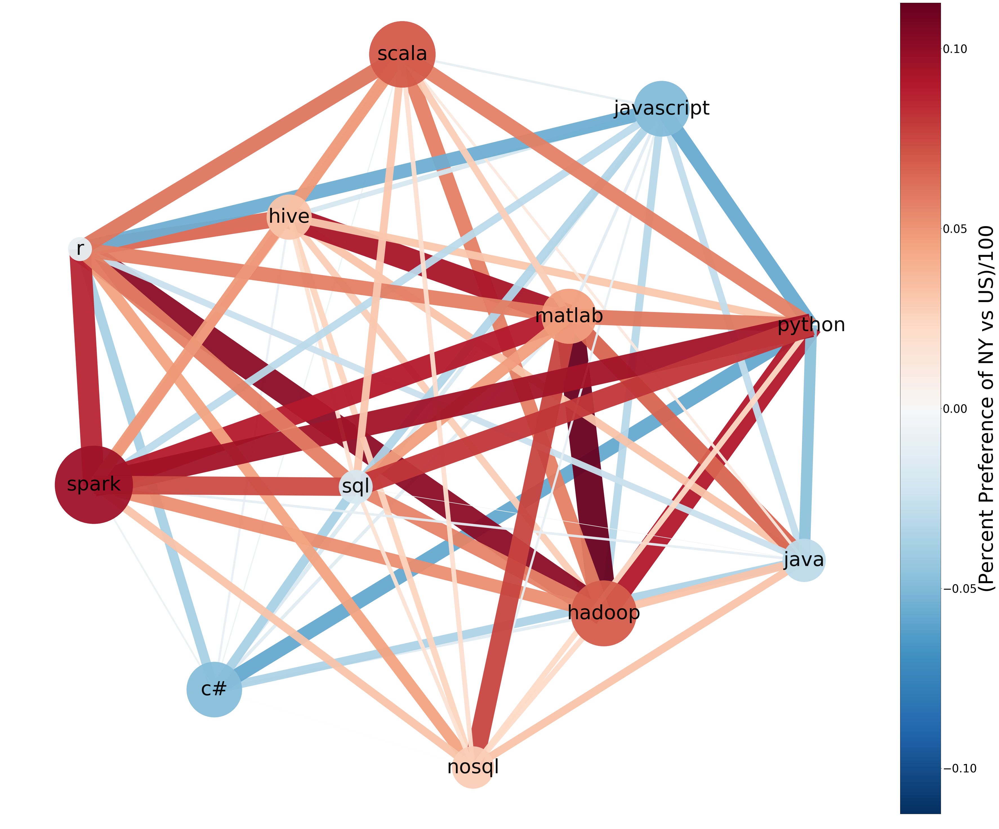

In [31]:
# Plot the normalized and pruned NY minus US data

# Make the threshold the xth percentile of all the values 
# when they are made to be positive
threshold = cooc_data_NY_US_normalized_diff.abs().quantile(.98)

pruned_pairs, pruned_skills_NY_US = pruneNodes(threshold, # The threshold
                                            cooc_data_NY_US_normalized_diff.abs(), # The absolute value of normalized pair data for NY minus US
                                            list(data_NY_US_normalized_diff.keys())) # The skills list for NY and US
# Get Nodes
nodes = pruned_skills_NY_US

# Get Node weights

node_weights = data_NY_US_normalized_diff[pruned_skills_NY_US].values

# Get the pairs
edges = [eval(x) for x in pruned_pairs]

# Get the pair weights
edge_weights = cooc_data_NY_US_normalized_diff[pruned_pairs].values

# Make the graph figure
G = nx.Graph()

# Add the list of names of the nodes
G.add_nodes_from(nodes)

# Add the list of names of the edges
G.add_edges_from(edges)

# Adjust the figure size
plt.figure(figsize=(50,40))

# Add Title
# plt.title('Difference in Normalized Skill Frequency and Cooccurance of Skills for NY and US (Pruned)',fontsize = 50)

# Use Fruchterman-Reingold force-directed algorithm to position the nodes.
graph_pos = nx.spring_layout(G)                 

# Coloring the graph
## We create a normal that will be used to color the nodes that will need a max and min 
## value

## Since the nodes and edges will be colored according to the same color bar, we will
## take the max and min from both sets combined and
## we will get the largest absolute value and use the positive and negative of that
## to make the colorbar symetrical

biggest_abs_value = max(
    np.abs(min(min(edge_weights),min(node_weights))), # get the smallest value from both sets
    np.abs(max(max(edge_weights),max(node_weights)))) # get the largest value from both sets

norm = mpl.colors.Normalize(vmin = -biggest_abs_value,
                            vmax = biggest_abs_value)

## We select the colormap that we want
cmap = mpl.cm.RdBu_r

## Now we get the RGBA values using our norm and cmap for the node_weights and edge_weights
## where the values will color according to where their values fall in the normalized scale
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
node_colors = m.to_rgba(node_weights)
edge_colors = m.to_rgba(edge_weights)

nx.draw(G,
        graph_pos, 
        # The values of the weights are both negative and positive, so the width will 
        # adjust according to the normalized absolute value of the width values
        width = [100*x for x in normalizeZeroOne(np.abs(edge_weights))],
 
        edge_color = edge_colors,
        
        # Add labels to the nodes
        with_labels = True,
        
        # Take the absolute value of the differences
        node_size = [abs(800000*x) for x in node_weights],
        
        # Use red to indicate positive and blue to indicate negative
        node_color = node_colors,
        
        # Make the edges and nodes transparent
        alpha=.95,
        font_size=70,
        font_color='k')

# Not sure what this does, but it is necessary to plot the colorbar to plot the colorbar
m._A = []

# Add the colorbar 
ax = plt.colorbar(m)

# Add label to colorbar
ax.set_label('(Percent Preference of NY vs US)/100',fontsize=70)

# Change the font size of the ticks
mpl.rcParams['font.size'] = 50.0
mpl.rcParams.update()

# Save the figure
plt.savefig('figures/NY_US_normalized_diff_pruned_graph.png',bbox_inches='tight',pad_inches=0.1)